<a href="https://colab.research.google.com/github/priyankadeep/Stripe-Dataset/blob/main/Stripe_task.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# importing relevant libraries
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import numpy as np

The files have been stored in a google drive. The step below is directly reading the files from the drive given the path.

In [ ]:
# reading all the files from google drive
df_payout = pd.read_csv('/content/drive/MyDrive/Stripe dataset/payouts (1).csv')
df_countries = pd.read_csv('/content/drive/MyDrive/Stripe dataset/countries - countries.csv.csv')
df_industries = pd.read_csv('/content/drive/MyDrive/Stripe dataset/industries - industries.csv.csv')


## Exploratory Data Analysis on each of the three files.
Checking for null and duplicated values.

Payout file does not have null values.

In [ ]:
# EDA on payouts csv file
df_payout.info()
print(f"\n {df_payout.head()}")
print(f"\nThe total no. of missing values in the dataframe are shown here:\n {df_payout.isna().sum()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1622642 entries, 0 to 1622641
Data columns (total 5 columns):
 #   Column        Non-Null Count    Dtype  
---  ------        --------------    -----  
 0   date          1622642 non-null  object 
 1   platform_id   1622642 non-null  object 
 2   recipient_id  1622642 non-null  object 
 3   count         1622642 non-null  int64  
 4   amount        1622642 non-null  float64
dtypes: float64(1), int64(1), object(3)
memory usage: 61.9+ MB

                         date                          platform_id  \
0  2018-05-16 00:00:00+00:00  id_5dded1fc8ff3f8c0d96019076394d2a7   
1  2018-11-23 00:00:00+00:00  id_424316eb0d974bebd1736fc4bd2eac3d   
2  2018-08-07 00:00:00+00:00  id_3702c1be346117616974e4127c952ab7   
3  2018-07-10 00:00:00+00:00  id_a1eafb7ca12772d4e8770b9b3566e608   
4  2018-01-07 00:00:00+00:00  id_a1eafb7ca12772d4e8770b9b3566e608   

                          recipient_id  count   amount  
0  id_23d90ec275370c686dedd7dc1c5e93

However, the date column is in atime series format. We only need the date to solve for the first question.
So, from the date column, we extract only the date part, transform it and store it back to the same column.

In [ ]:
#Transforming the date column for better readability
df_payout['date'] = pd.to_datetime(df_payout['date'])
df_payout['date'] = df_payout['date'].dt.date

# Question 1:

# Rationale:
To estimate the average payout to be made to each country on 1st Jan 2019, we will use predictive analytics,i.e. we will use historical data(data from 2018) to see the trend and estimate the behaviour on 1st Jan.

# Approach:
First we calcuate to see which day of the week is the payout to be determined for. In our case, it falls on a tuesday. Now, using data from 2018, we will analyze payouts made on each tuesdays of the year(present in our data), and then average it out to estimate an amount for the 1st.

The amount column has numeric values expressed in cents. For businesses, it is better to provide estimates in thousand denominations. To achieve this, we divide each amount values by 1000.

Further, based on the date extracted we determine which day of the week was the payout made in 2018. This will help us give a better estimate for the payout to be made on 1 jan 2019.

In [ ]:
# Converting the amount from cents to thousands
df_payout['amount(1000$)'] = df_payout['amount'].apply(lambda x: x / 100000)

# Extracting the date only from the time series column and then adding a new column 'weekday'.
# Based on the step from above, determining the day of the week
df_payout['weekday'] = pd.to_datetime(df_payout['date'])
df_payout['weekday'] = df_payout['weekday'].dt.dayofweek

Countries file has a few null values.

In [ ]:
# EDA on countries csv file
df_countries.info()
print(f"\n {df_countries.head()}")
print(f"\nThe total no. of missing values in the dataframe are shown here:\n {df_countries.isna().sum()}")
print(f"\nThe total no. of duplicated entries in the dataframe are shown here:\n {df_countries.duplicated().sum()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112309 entries, 0 to 112308
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   merchant_id  112309 non-null  object
 1   country      112309 non-null  object
dtypes: object(2)
memory usage: 1.7+ MB

                            merchant_id country
0  id_ace715763434d4fd4eda58c9e9d692c6      FR
1  id_717b4a0f74912f18146c0708b330a3d9      US
2  id_671fd54bccd294b502fea89c0cc5a690      US
3  id_d8ed94b4e446b868e38efa8efa34b702      FR
4  id_1a054e523cbf203b16b38fc3e5b19b25      US

The total no. of missing values in the dataframe are shown here:
 merchant_id    0
country        0
dtype: int64

The total no. of duplicated entries in the dataframe are shown here:
 0


Industries file has one null entry.

In [ ]:
# EDA on industries csv file
df_industries.info()
print(f"\n {df_industries.head()}")
print(f"\nThe total % missing values in the dataframe are shown here:\n {df_industries.isna().sum()}")
na_rows = df_industries[df_industries.isna().any(axis=1)]
print(na_rows)
print(f"\nThe total no. of duplicated entries in the dataframe are shown here:\n {df_industries.duplicated().sum()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112309 entries, 0 to 112308
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   merchant_id  112309 non-null  object
 1   industry     112308 non-null  object
dtypes: object(2)
memory usage: 1.7+ MB

                            merchant_id                             industry
0  id_ace715763434d4fd4eda58c9e9d692c6                 Travel & Hospitality
1  id_717b4a0f74912f18146c0708b330a3d9                      Food & Beverage
2  id_671fd54bccd294b502fea89c0cc5a690  Professional Services (non-medical)
3  id_d8ed94b4e446b868e38efa8efa34b702                 Travel & Hospitality
4  id_1a054e523cbf203b16b38fc3e5b19b25  Professional Services (non-medical)

The total % missing values in the dataframe are shown here:
 merchant_id    0
industry       1
dtype: int64
                               merchant_id industry
70951  id_b877e047c48a77aa883cd3bbba95ce58      NaN

The total 

Now that we have perfomed preliminary EDA on all files, its time to answer join the payout file and the countries file.
We use a left join and merge the data to a new df and drop the redundant 'merchant_id' column. The missing values from countries file have been grouped in a new category named 'unknown'. The missing values account for a very low share as compared to the dataset so dropping the missing data could also be an alternative.

In [ ]:
# Merge the dataframes based on recipient_id and merchant_id
df_payout_country_merged = pd.merge(df_payout, df_countries, left_on='recipient_id', right_on='merchant_id', how='left')
df_payout_country_merged.drop(columns=['merchant_id'], inplace=True)
print(f"\nThe total no. of missing values in the dataframe are shown here:\n {df_payout_country_merged.isna().sum()}")
# Replacing NaN values with Unknown to create a new category
df_payout_country_merged['country'].fillna('Unknown', inplace=True)


The total no. of missing values in the dataframe are shown here:
 date                 0
platform_id          0
recipient_id         0
count                0
amount               0
amount(1000$)        0
weekday              0
country          13166
dtype: int64


Now we created a new df with only the columns that we need for the final estimation

In [ ]:
# Creating a new df with only relevant columns
df_payout_country_merged_1 = df_payout_country_merged[['recipient_id','amount(1000$)','weekday','country']]
df_payout_country_merged_1

,recipient_id,amount(1000$),weekday,country
0,id_23d90ec275370c686dedd7dc1c5e93b3,0.09786,2,US
1,id_72f05535ba5e6e5b141db6b5c1f1b13b,0.03750,4,FR
2,id_d70e8046fe5583e1154b2e077133e27c,0.02258,1,GB
3,id_1a336bd21b4bfd9810e0510e1a5f7ec2,0.20369,1,US
4,id_c577aeddec71607ec0be1f94bef025da,0.34922,6,US
...,...,...,...,...
1622637,id_e4dff590a6728c8c27a35203f9443c58,0.26284,3,US
1622638,id_c37e45a5b586f8fda03482b553885e81,0.08632,1,JP
1622639,id_e027ff25aae5b91268d99907710de5c1,0.33243,2,US
1622640,id_39a6f54346d9c62050ea03fad9693f8f,0.11882,3,US


In [ ]:
# Grouping the new df by weekday and country to estimate the amount
df_payout_country_merged_1 = df_payout_country_merged_1.groupby(['weekday', 'country'], as_index=False).sum()
df_payout_country_merged_1

,weekday,country,recipient_id,amount(1000$)
0,0,AT,id_596e2fb4488c9a73900c3666e325e220id_312cb913...,59.99371
1,0,AU,id_cbe8a774431823f02d74c149ca3acc22id_6c69aeb0...,1373.56356
2,0,BE,id_8635a6b5b4aeae4510dfe27cb3875a35id_c376762f...,308.90536
3,0,BR,id_5055aa371cac4840721108b121f86fe3id_ffe3abae...,117.93376
4,0,CA,id_462a59ef9dc9b710fcb109ae2712be5did_932a2a99...,2943.51326
...,...,...,...,...
174,6,PT,id_b9da3bfadbb834a0ae3aa5cccbcc66a6id_85de5960...,20.02176
175,6,SE,id_827807c7e5d4d3b66938c07c439bc9bdid_5da442f8...,134.24244
176,6,SG,id_d610eb4e26c64aa4f10e51cd74fce1fbid_cf6ddbed...,94.15636
177,6,US,id_c577aeddec71607ec0be1f94bef025daid_fa3127dc...,141726.23336


In [ ]:
df_payout_country_merged_wk = df_payout_country_merged_1.groupby(['weekday'], as_index=False).sum()
df_payout_country_merged_wk

,weekday,country,recipient_id,amount(1000$)
0,0,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPLUMXNLNONZPTSE...,id_596e2fb4488c9a73900c3666e325e220id_312cb913...,197253.61230
1,1,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPLUMXNLNONZPTSE...,id_346e5f1dbd576fc15ea840a4a66f8d49id_e8986576...,294797.58880
2,2,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPLUMXNLNONZPTSE...,id_5004373ed3027c86f08559ab435661f3id_48841690...,243734.12983
3,3,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPMXNLNONZPTSESG...,id_bfdf6062b66c2a6b97d285c6ce5728c8id_7938f990...,201123.16854
4,4,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPMXNLNONZPTSESG...,id_2a69f465f157bf5e31794084d0edbbbaid_bd7e156f...,149773.04961
5,5,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPMXNLNONZPTSESG...,id_fe33dc6d16929c1931458547e15c9371id_0ce08a19...,104490.81672
6,6,ATAUBEBRCACHDEDKESFIFRGBHKIEITJPLUMXNLNONZPTSE...,id_9baaecca18c64c123bf0660524a092c3id_fac1f17b...,153802.53159


<ipython-input-65-de03d9a26c02>:24: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='Amount (1000$)')  # Add a colorbar for reference


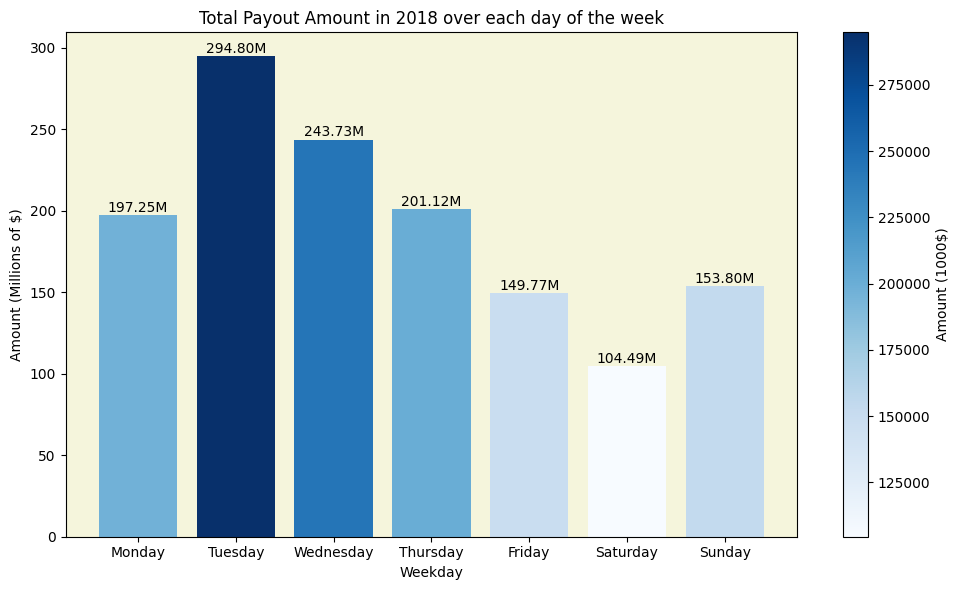

In [ ]:
# Create a colormap
from matplotlib.cm import Blues
from matplotlib.colors import Normalize
import matplotlib.pyplot as plt

# Create a colormap
cmap = Blues
norm = Normalize(vmin=min(df_payout_country_merged_wk['amount(1000$)']), vmax=max(df_payout_country_merged_wk['amount(1000$)']))  # Normalize the data

plt.figure(figsize=(10, 6))
plt.gca().set_facecolor('beige')  # Set the background color of the plot area
bars = plt.bar(df_payout_country_merged_wk['weekday'], df_payout_country_merged_wk['amount(1000$)'] / 1000, color=cmap(norm(df_payout_country_merged_wk['amount(1000$)'])))  # Use the colormap for coloring the bars
plt.xlabel('Weekday')
plt.ylabel('Amount (Millions of $)')
plt.title('Total Payout Amount in 2018 over each day of the week')

# Change the x-axis labels
weekday_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.xticks(df_payout_country_merged_wk['weekday'], weekday_labels)  # Set custom x-axis tick labels

# Create a ScalarMappable object for the colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Dummy array required for the colorbar
plt.colorbar(sm, label='Amount (1000$)')  # Add a colorbar for reference

# Add value labels over each bar
for bar, amount in zip(bars, df_payout_country_merged_wk['amount(1000$)']):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 0.1, f'{amount / 1000:.2f}M', ha='center', va='bottom')

plt.tight_layout()
plt.show()


Filtering the data where weekday == 1,i.e. where the payout was made on a tuesday.

In [ ]:
# Calculating the payout on tuesdays of 2018 by country
df_payout_country_merged_1 = df_payout_country_merged_1[df_payout_country_merged_1['weekday']== 1]
df_payout_country_merged_1

,weekday,country,recipient_id,amount(1000$)
26,1,AT,id_346e5f1dbd576fc15ea840a4a66f8d49id_e8986576...,175.48883
27,1,AU,id_5b27a3c0f978972bac746b15ffbfbf2fid_eed78d39...,2725.86024
28,1,BE,id_fbf183bc75543913e4e8254c99004a62id_b6d30362...,231.48953
29,1,BR,id_4b0d179b6f5c0d62b9bb850bc2e9d61did_7ab6e131...,148.90838
30,1,CA,id_fc87b026ac6973ef47cb926d192ca082id_7c3e2b77...,3680.16026
31,1,CH,id_f9e28675c71840f8225082fc7588188fid_770a1d70...,139.54734
32,1,DE,id_6bdd7fa4c4056bcd56dd1bcec0b6daa1id_b4fffe61...,1435.43346
33,1,DK,id_af347c336d7ad95658cca048b2e1c2b3id_085c1589...,94.77140
34,1,ES,id_fe926821a3995a35a766dc1ed9098069id_28794964...,1088.30410
35,1,FI,id_5cefd2948f427fa37310bacd2f221898id_a68eb45f...,105.38809


In [ ]:
# Dividing the amount from above by 52 to get an estimate of payouts of tuesdays
df_payout_country_merged_1['estimated_amount_1jan(1000$)'] = df_payout_country_merged_1['amount(1000$)'].div(52)
df_payout_country_merged_1

<ipython-input-67-f77c57386e6d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_payout_country_merged_1['estimated_amount_1jan(1000$)'] = df_payout_country_merged_1['amount(1000$)'].div(52)


,weekday,country,recipient_id,amount(1000$),estimated_amount_1jan(1000$)
26,1,AT,id_346e5f1dbd576fc15ea840a4a66f8d49id_e8986576...,175.48883,3.374785
27,1,AU,id_5b27a3c0f978972bac746b15ffbfbf2fid_eed78d39...,2725.86024,52.420389
28,1,BE,id_fbf183bc75543913e4e8254c99004a62id_b6d30362...,231.48953,4.451722
29,1,BR,id_4b0d179b6f5c0d62b9bb850bc2e9d61did_7ab6e131...,148.90838,2.863623
30,1,CA,id_fc87b026ac6973ef47cb926d192ca082id_7c3e2b77...,3680.16026,70.772313
31,1,CH,id_f9e28675c71840f8225082fc7588188fid_770a1d70...,139.54734,2.683603
32,1,DE,id_6bdd7fa4c4056bcd56dd1bcec0b6daa1id_b4fffe61...,1435.43346,27.604490
33,1,DK,id_af347c336d7ad95658cca048b2e1c2b3id_085c1589...,94.77140,1.822527
34,1,ES,id_fe926821a3995a35a766dc1ed9098069id_28794964...,1088.30410,20.928925
35,1,FI,id_5cefd2948f427fa37310bacd2f221898id_a68eb45f...,105.38809,2.026694


In [ ]:
# Plotting the vestimated amount vs country. Taking log of y-axis to normalize the data for better visualization
plt.figure(figsize=(12, 6))
bars = plt.bar(df_payout_country_merged_1['country'], df_payout_country_merged_1['estimated_amount_1jan(1000$)'], color='skyblue')
plt.xlabel('Country')
plt.ylabel('Estimated Payout Amount (1000$)')
plt.title('Estimated Payout Amount by Country in 2019')
plt.xticks(rotation=45, ha='right')
plt.yscale('log')  # Set y-axis to logarithmic scale

# Inserting values on each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 2), ha='center', va='bottom')

plt.tight_layout()
plt.show()


# Question 2:

Let's first look at how many industries are there in the file.

In [ ]:
df_industries['industry'].value_counts()

industry
Other Software & Content                             26037
Travel & Hospitality                                 18370
Other Services                                       15902
Professional Services (non-medical)                  14527
Food & Beverage                                      12221
Non-profit                                            9269
Tickets: concerts,sports,movies,conventions           8081
Content                                               4730
Education                                             1010
Retail Fashion                                         994
Other Retail                                           603
Healthcare                                             389
Direct Services: classes,memberships,appointments      171
Financial Services                                       1
internet software & services                             1
Real Estate                                              1
hotels, restaurants & leisure                  

In the list, we see there are multiple groups of industries. There is one under "hotel" group. For better results, I grouped travel and hospitality and hotels into one group.

In [ ]:
df_industries['industry'] = df_industries['industry'].str.replace('Travel & Hospitality','hotels, restaurants & leisure' )

Using a left join, we merge both files,i.e. payouts and industries. We will not require dates and count columns, so we drop them.

In [ ]:
#create another df and delete some columns
df_payouts_industries_merged = pd.merge(df_payout, df_industries, how='left', left_on='platform_id', right_on='merchant_id')
df_payouts_industries_merged = df_payouts_industries_merged.drop(['date','recipient_id','count'], axis = 1)
df_payouts_industries_merged

,platform_id,amount,amount(1000$),weekday,merchant_id,industry
0,id_5dded1fc8ff3f8c0d96019076394d2a7,9786.0,0.09786,2,id_5dded1fc8ff3f8c0d96019076394d2a7,"Tickets: concerts,sports,movies,conventions"
1,id_424316eb0d974bebd1736fc4bd2eac3d,3750.0,0.03750,4,id_424316eb0d974bebd1736fc4bd2eac3d,"hotels, restaurants & leisure"
2,id_3702c1be346117616974e4127c952ab7,2258.0,0.02258,1,id_3702c1be346117616974e4127c952ab7,Content
3,id_a1eafb7ca12772d4e8770b9b3566e608,20369.0,0.20369,1,id_a1eafb7ca12772d4e8770b9b3566e608,Non-profit
4,id_a1eafb7ca12772d4e8770b9b3566e608,34922.0,0.34922,6,id_a1eafb7ca12772d4e8770b9b3566e608,Non-profit
...,...,...,...,...,...,...
1622637,id_5dded1fc8ff3f8c0d96019076394d2a7,26284.0,0.26284,3,id_5dded1fc8ff3f8c0d96019076394d2a7,"Tickets: concerts,sports,movies,conventions"
1622638,id_4fbd94bb830c62816abb07d6544bd707,8632.0,0.08632,1,id_4fbd94bb830c62816abb07d6544bd707,Other Services
1622639,id_296420e88b94f7b67b7bb305ac82a0e4,33243.0,0.33243,2,id_296420e88b94f7b67b7bb305ac82a0e4,Food & Beverage
1622640,id_48ba75d17cfea6d24ca5ba8dd72559a0,11882.0,0.11882,3,id_48ba75d17cfea6d24ca5ba8dd72559a0,Education


In [ ]:
#grouping the df by industry and counting the unique platforms for each industry
df_platforms_industries_sum = df_payouts_industries_merged.drop(['platform_id','weekday','merchant_id'], axis = 1)
df_platforms_industries_sum = df_platforms_industries_sum.groupby(('industry'), as_index=False).sum()
df_platforms_industries_sum

,industry,amount,amount(1000$)
0,Content,1.157113e+09,11571.13143
1,"Direct Services: classes,memberships,appointments",1.569166e+08,1569.16563
2,Education,2.950257e+09,29502.56823
3,Financial Services,6.613435e+07,661.34349
4,Food & Beverage,4.217981e+09,42179.81481
5,Healthcare,1.626471e+09,16264.70647
6,Non-profit,1.678257e+10,167825.65669
7,Other Retail,1.217618e+08,1217.61826
8,Other Services,3.214291e+09,32142.90813
9,Other Software & Content,1.546404e+10,154640.37382


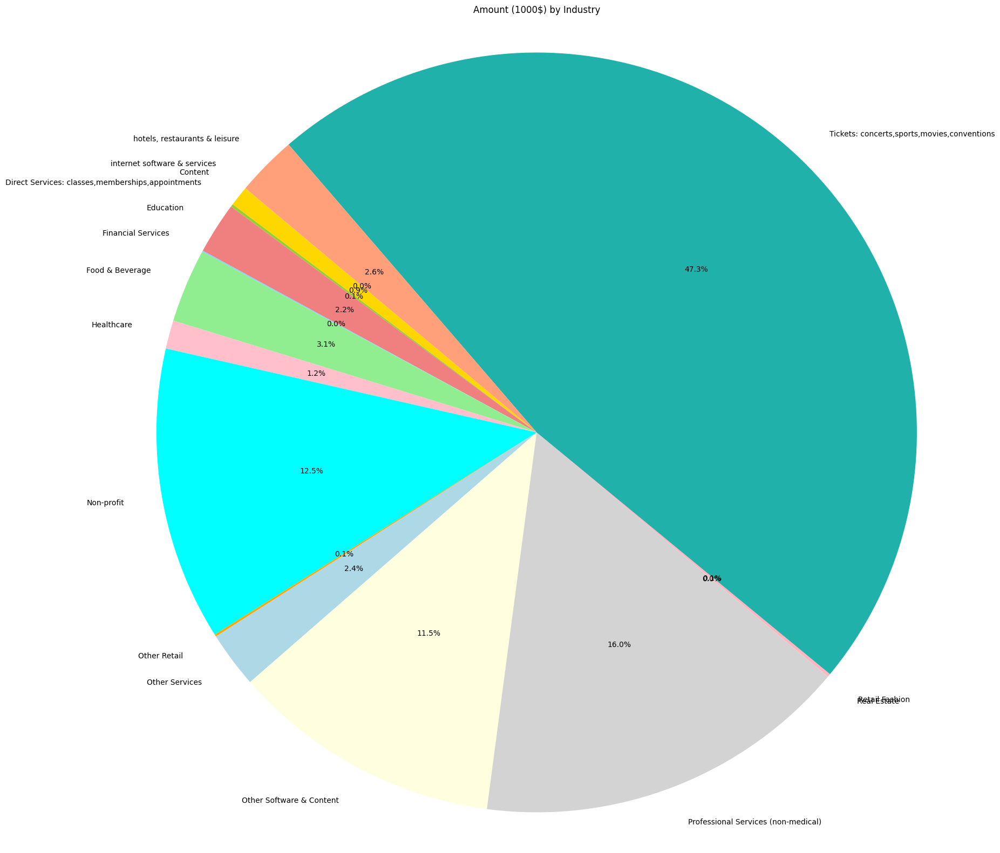

In [ ]:
# Plotting the pie chart
plt.figure(figsize=(20, 20))
# Define custom colors
colors = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'lightgreen', 'pink', 'cyan',
          'orange', 'lightblue', 'lightyellow', 'lightgrey', 'lavender', 'lightpink', 'lightseagreen',
          'lightsalmon', 'lightsteelblue']
plt.pie(df_platforms_industries_sum['amount(1000$)'], labels=df_platforms_industries_sum['industry'], autopct='%1.1f%%', startangle=140, colors=colors)
plt.title('Amount (1000$) by Industry')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

Now we see the unique industries with the count of unique platforms. This will help us analyze and estimate the payout volume better.

In [ ]:
#grouping the df by industry and counting the unique platforms for each industry
df_platforms_industries = df_payouts_industries_merged.groupby('industry')['platform_id'].nunique()
df_platforms_industries

industry
Content                                                6
Direct Services: classes,memberships,appointments      7
Education                                              5
Financial Services                                     1
Food & Beverage                                       15
Healthcare                                             5
Non-profit                                            16
Other Retail                                          10
Other Services                                       105
Other Software & Content                             178
Professional Services (non-medical)                   24
Real Estate                                            1
Retail Fashion                                        19
Tickets: concerts,sports,movies,conventions           10
hotels, restaurants & leisure                         13
internet software & services                           1
Name: platform_id, dtype: int64

In [ ]:
#remove unneccessary columns
df_payouts_industries_merged.info()
df_payouts_industries_merged = df_payouts_industries_merged.drop(['platform_id','merchant_id'], axis = 1)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1622642 entries, 0 to 1622641
Data columns (total 6 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   platform_id    1622642 non-null  object 
 1   amount         1622642 non-null  float64
 2   amount(1000$)  1622642 non-null  float64
 3   weekday        1622642 non-null  int32  
 4   merchant_id    1622437 non-null  object 
 5   industry       1622432 non-null  object 
dtypes: float64(2), int32(1), object(3)
memory usage: 68.1+ MB


In [ ]:
#Grouping the df based on only the 3 industries
df_payouts_industries_merged_1 = df_payouts_industries_merged.groupby(['industry','weekday'], as_index=False).sum()
industries = ['Education','Food & Beverage', 'hotels, restaurants & leisure']
df_payouts_industries_merged_2 = df_payouts_industries_merged_1[df_payouts_industries_merged_1.industry.isin(industries)]

In [ ]:
df_payouts_industries_merged_2

,industry,weekday,amount,amount(1000$)
14,Education,0,6.628098e+08,6628.09847
15,Education,1,9.448335e+08,9448.33509
16,Education,2,5.089684e+08,5089.68407
17,Education,3,4.424264e+08,4424.26442
18,Education,4,3.612140e+06,36.12140
19,Education,5,2.577729e+06,25.77729
20,Education,6,3.850287e+08,3850.28749
28,Food & Beverage,0,5.313783e+08,5313.78348
29,Food & Beverage,1,4.496764e+08,4496.76394
30,Food & Beverage,2,2.402195e+09,24021.95057


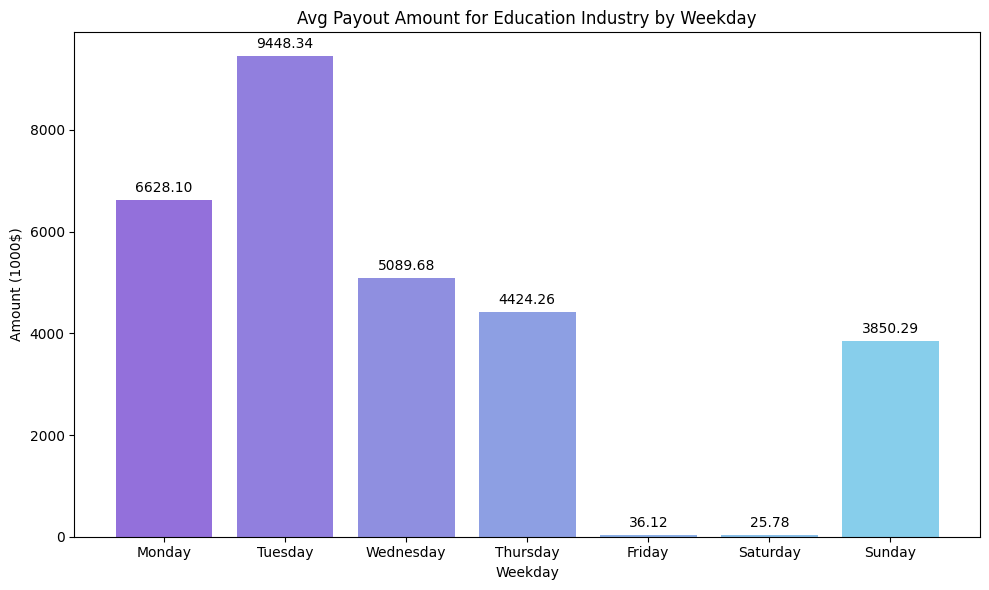

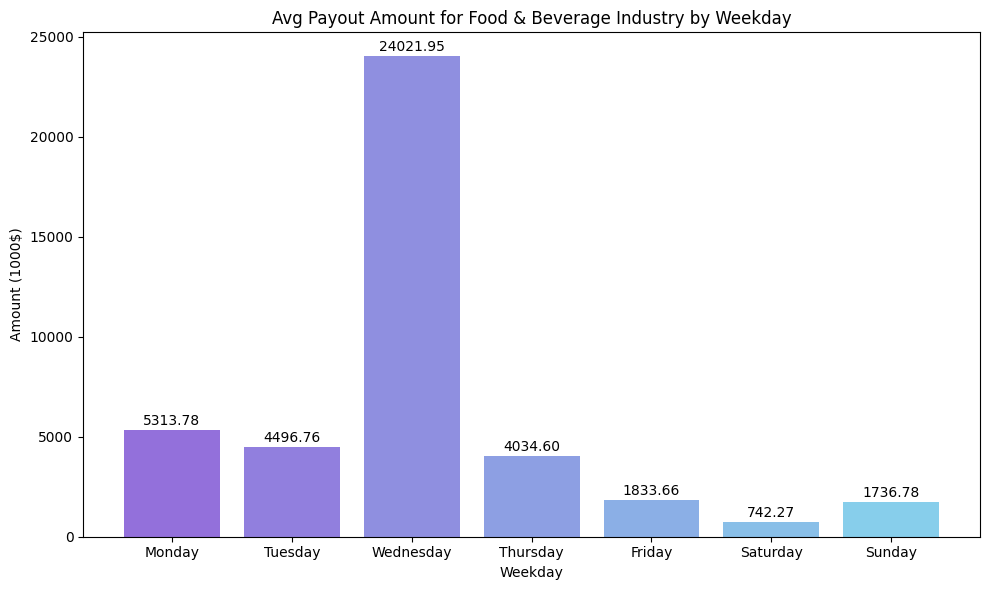

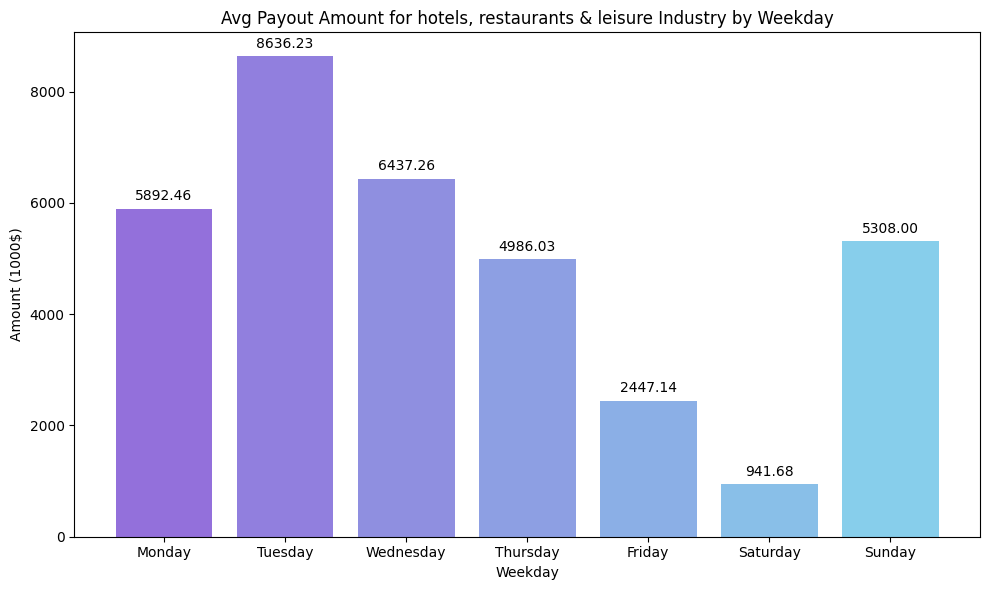

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
# List of unique industry categories
categories = df_payouts_industries_merged_2['industry'].unique()

# Define the gradient color map
colors = ['mediumpurple', 'skyblue']  # Start and end colors for the gradient
cmap = LinearSegmentedColormap.from_list('mycmap', colors)

# Plotting each category in separate graphs
for category in categories:
    plt.figure(figsize=(10, 6))

    # Filter data for the current category
    df_category = df_payouts_industries_merged_2[df_payouts_industries_merged_2['industry'] == category]

    # Calculate the color gradient for each bar
    gradient_colors = np.linspace(0, 1, len(df_category))

    # Change the x-axis labels
    weekday_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    plt.xticks(df_category['weekday'], weekday_labels)  # Set custom x-axis tick labels

    bars = plt.bar(df_category['weekday'], df_category['amount(1000$)'], color=cmap(gradient_colors))
    plt.xlabel('Weekday')
    plt.ylabel('Amount (1000$)')
    plt.title(f'Avg Payout Amount for {category} Industry by Weekday')
    plt.xticks(df_category['weekday'])

    # Add value labels over each bar
    for bar, amount in zip(bars, df_category['amount(1000$)']):
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 100, f'{amount:.2f}', ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

There is going to be changes to the platform count for the three industries. To calculate the amount, we will multiply the amount with the growth coefficients.

In [ ]:
#Filtering the df based on only the 3 industries
df_education = df_payouts_industries_merged_2[df_payouts_industries_merged_2.industry == 'Education']
df_food_beverage = df_payouts_industries_merged_2[df_payouts_industries_merged_2.industry == 'Food & Beverage']
df_hotel = df_payouts_industries_merged_2[df_payouts_industries_merged_2.industry == 'hotels, restaurants & leisure']
#multiply payout by expected growth in the number of platforms by industry
df_hotel['amount_exp(1000$)'] = df_hotel['amount(1000$)']*(5/13)
df_hotel['amount_exp(1000$/day)'] = df_hotel['amount_exp(1000$)']/52
df_food_beverage['amount_exp(1000$)'] = df_food_beverage['amount(1000$)']*(40/15)
df_food_beverage['amount_exp(1000$/day)'] = df_food_beverage['amount_exp(1000$)']/52
df_education['amount_exp(1000$)'] = df_education['amount(1000$)']*(15/5)
df_education['amount_exp(1000$/day)'] = df_education['amount_exp(1000$)']/52


<ipython-input-80-9d8bce6f555a>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_hotel['amount_exp(1000$)'] = df_hotel['amount(1000$)']*(5/13)
<ipython-input-80-9d8bce6f555a>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_hotel['amount_exp(1000$/day)'] = df_hotel['amount_exp(1000$)']/52
<ipython-input-80-9d8bce6f555a>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documenta

In [ ]:
df_hotel

,industry,weekday,amount,amount(1000$),amount_exp(1000$),amount_exp(1000$/day)
96,"hotels, restaurants & leisure",0,589246359.0,5892.46359,2266.332150,43.583311
97,"hotels, restaurants & leisure",1,863622718.0,8636.22718,3321.625838,63.877420
98,"hotels, restaurants & leisure",2,643726413.0,6437.26413,2475.870819,47.612900
99,"hotels, restaurants & leisure",3,498603013.0,4986.03013,1917.703896,36.878921
100,"hotels, restaurants & leisure",4,244714092.0,2447.14092,941.208046,18.100155
101,"hotels, restaurants & leisure",5,94168479.0,941.68479,362.186458,6.965124
102,"hotels, restaurants & leisure",6,530799933.0,5307.99933,2041.538204,39.260350


In [ ]:
#total payout
df_total_payout = df_payouts_industries_merged_2
df_total_payout = df_total_payout.drop(['weekday','amount'], axis = 1).groupby(['industry'], as_index=False).sum()
df_total_payout

,industry,amount(1000$)
0,Education,29502.56823
1,Food & Beverage,42179.81481
2,"hotels, restaurants & leisure",34648.81007


In [ ]:
#multiply payout by expected growth in the number of platforms by industry
df_total_payout_education = df_total_payout[df_total_payout.industry == 'Education']
df_total_payout_education['amount(1000$/day)'] = df_total_payout_education['amount(1000$)']/365
df_total_payout_education['amount_exp(1000$)'] = df_total_payout_education['amount(1000$)']*(15/5)
df_total_payout_education['amount_exp(1000$/day)'] = df_total_payout_education['amount_exp(1000$)']/365

df_total_payout_hotel = df_total_payout[df_total_payout.industry == 'hotels, restaurants & leisure']
df_total_payout_hotel['amount(1000$/day)'] = df_total_payout_hotel['amount(1000$)']/365
df_total_payout_hotel['amount_exp(1000$)'] = df_total_payout_hotel['amount(1000$)']*(5/13)
df_total_payout_hotel['amount_exp(1000$/day)'] = df_total_payout_hotel['amount_exp(1000$)']/365

df_total_payout_food = df_total_payout[df_total_payout.industry == 'Food & Beverage']
df_total_payout_food['amount(1000$/day)'] = df_total_payout_food['amount(1000$)']/365
df_total_payout_food['amount_exp(1000$)'] = df_total_payout_food['amount(1000$)']*(40/15)
df_total_payout_food['amount_exp(1000$/day)'] = df_total_payout_food['amount_exp(1000$)']/365


<ipython-input-83-192e11acbdcc>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_total_payout_education['amount(1000$/day)'] = df_total_payout_education['amount(1000$)']/365
<ipython-input-83-192e11acbdcc>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_total_payout_education['amount_exp(1000$)'] = df_total_payout_education['amount(1000$)']*(15/5)
<ipython-input-83-192e11acbdcc>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

In [ ]:
df_total_payout_food

,industry,amount(1000$),amount(1000$/day),amount_exp(1000$),amount_exp(1000$/day)
1,Food & Beverage,42179.81481,115.561136,112479.50616,308.163031


In [ ]:
df_total_payout_education

,industry,amount(1000$),amount(1000$/day),amount_exp(1000$),amount_exp(1000$/day)
0,Education,29502.56823,80.828954,88507.70469,242.486862


In [ ]:
df_total_payout_hotel

,industry,amount(1000$),amount(1000$/day),amount_exp(1000$),amount_exp(1000$/day)
2,"hotels, restaurants & leisure",34648.81007,94.928247,13326.465412,36.510864


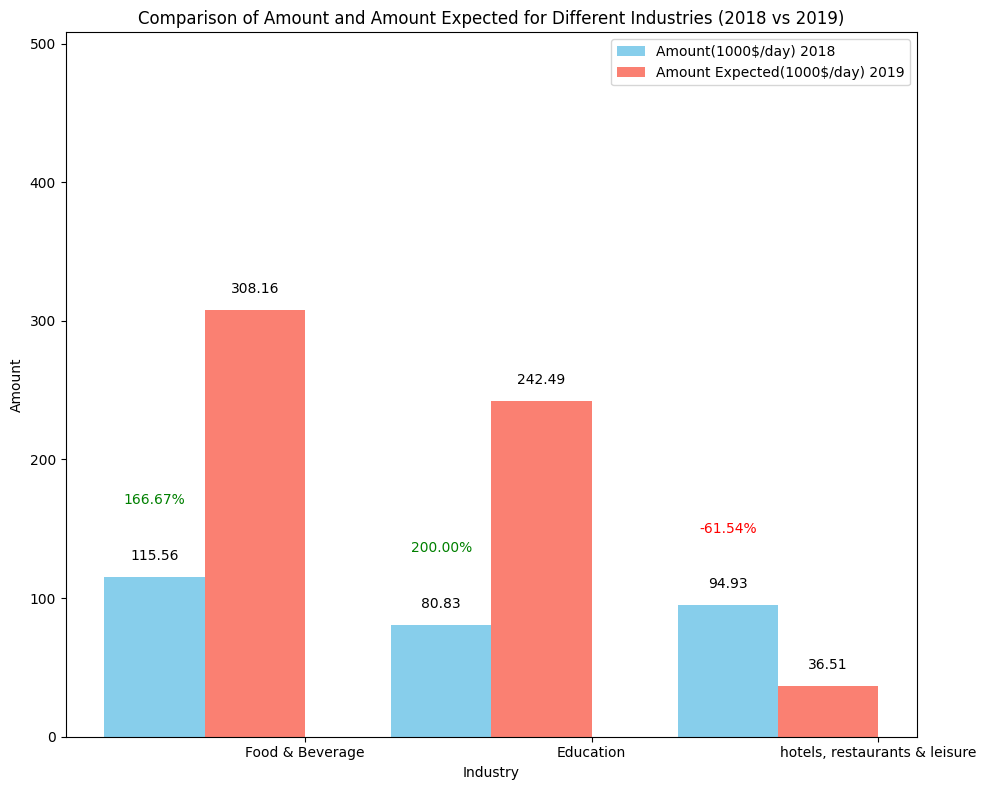

In [ ]:
# Combining all industry data
df_combined = pd.concat([df_total_payout_food, df_total_payout_education, df_total_payout_hotel])


# Calculate percentage change
df_combined['percentage_change'] = ((df_combined['amount_exp(1000$/day)'] - df_combined['amount(1000$/day)']) / df_combined['amount(1000$/day)']) * 100

# Bar width
width = 0.35

# Position of bars on x-axis
x = range(len(df_combined['industry']))

# Plotting the bar graph
plt.figure(figsize=(10, 8))


# Bar for 2018 data
bars1 = plt.bar(x, df_combined['amount(1000$/day)'], width, label='Amount(1000$/day) 2018', color='skyblue')
bars2 = plt.bar([p + width for p in x], df_combined['amount_exp(1000$/day)'], width, label='Amount Expected(1000$/day) 2019', color='salmon')

# Add value labels for each bar
for bar in bars1:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 10, f'{yval:.2f}', ha='center', va='bottom')

for bar in bars2:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 10, f'{yval:.2f}', ha='center', va='bottom')



# Add percentage change labels next to each bar
for i, bar in enumerate(bars1):
    change = df_combined.iloc[i]['percentage_change']
    label = f'{change:.2f}%'
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 50, label, ha='center', va='bottom', color='red' if change < 0 else 'green')


# Labeling the axes and title
plt.xlabel('Industry')
plt.ylabel('Amount')
plt.title('Comparison of Amount and Amount Expected for Different Industries (2018 vs 2019)')
plt.xticks([p + 1.5 * width for p in x], df_combined['industry'])
plt.legend()

# Adjusting the y-axis limits
plt.ylim(0, max(df_combined['amount_exp(1000$/day)']) + 200)

plt.tight_layout()
plt.show()


In [3]:
! jupyter nbconvert --to html Stripe_task-3.ipynb

[NbConvertApp] Converting notebook Stripe_task-3.ipynb to html
[NbConvertApp] ERROR | Notebook JSON is invalid: Additional properties are not allowed ('metadata' was unexpected)

Failed validating 'additionalProperties' in stream:

On instance['cells'][37]['outputs'][0]:
{'metadata': {'tags': None},
 'name': 'stdout',
 'output_type': 'stream',
 'text': "<class 'pandas.core.frame.DataFrame'>\n"
         'RangeIndex: 1622642 entrie...'}
[NbConvertApp] Writing 1291691 bytes to Stripe_task-3.html
